In [0]:
#!pip install pyspark

In [0]:
#pip install matplotlib seaborn

In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, sum
from pyspark.sql.functions import to_date
from pyspark.sql.functions import lit
from pyspark.sql.functions import rand
from pyspark.sql.functions import date_format
from pyspark.ml.stat import Summarizer
from pyspark.sql import functions as F
import random


In [0]:
# Initialisez une session Spark
spark = SparkSession.builder.appName("segmentation-clientele").getOrCreate()

# Chemin vers les fichiers Excel
chemin_bikes = "/FileStore/tables/bikes.csv"
chemin_bikeshops ="/FileStore/tables/bikeshops.csv"
chemin_orders = "/FileStore/tables/orders.csv"

file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ";"

# Lisez les données à partir d'un fichier CSV

df_bikes = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(chemin_bikes)

df_bikeshops = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(chemin_bikeshops)

df_orders = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(chemin_orders)


print(df_bikes.count())
print(df_bikeshops.count())
print(df_orders.count())



97
30
15644


In [0]:
#nettoyage df_bikes

df_bikes.show(5)
display(df_bikes)

df_bikes = df_bikes.withColumnRenamed("bike.id", "bike_id") # renommé la colonne bike.id

#reperage des valeurs manquantes
valeurs_manquantes = df_bikes.select([sum(col(c).isNull().cast("int")).alias(c) for c in df_bikes.columns])
valeurs_manquantes.show()
df_bikes = df_bikes.drop_duplicates() #suppression doublon
print(df_bikes.count())


+-------+--------------------+---------+----------+------+-----+
|bike.id|               model|category1| category2| frame|price|
+-------+--------------------+---------+----------+------+-----+
|      1|Supersix Evo Blac...|     Road|Elite Road|Carbon|12790|
|      2|Supersix Evo Hi-M...|     Road|Elite Road|Carbon|10660|
|      3|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 7990|
|      4|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 5330|
|      5|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 4260|
+-------+--------------------+---------+----------+------+-----+
only showing top 5 rows

+-------+-----+---------+---------+-----+-----+
|bike_id|model|category1|category2|frame|price|
+-------+-----+---------+---------+-----+-----+
|      0|    0|        0|        0|    0|    0|
+-------+-----+---------+---------+-----+-----+

97


bike.id,model,category1,category2,frame,price
1,Supersix Evo Black Inc.,Road,Elite Road,Carbon,12790
2,Supersix Evo Hi-Mod Team,Road,Elite Road,Carbon,10660
3,Supersix Evo Hi-Mod Dura Ace 1,Road,Elite Road,Carbon,7990
4,Supersix Evo Hi-Mod Dura Ace 2,Road,Elite Road,Carbon,5330
5,Supersix Evo Hi-Mod Utegra,Road,Elite Road,Carbon,4260
6,Supersix Evo Red,Road,Elite Road,Carbon,3940
7,Supersix Evo Ultegra 3,Road,Elite Road,Carbon,3200
8,Supersix Evo Ultegra 4,Road,Elite Road,Carbon,2660
9,Supersix Evo 105,Road,Elite Road,Carbon,2240
10,Supersix Evo Tiagra,Road,Elite Road,Carbon,1840


In [0]:
df_bikes.show(5)

+-------+--------------------+---------+----------+------+-----+
|bike_id|               model|category1| category2| frame|price|
+-------+--------------------+---------+----------+------+-----+
|      2|Supersix Evo Hi-M...|     Road|Elite Road|Carbon|10660|
|      5|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 4260|
|      3|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 7990|
|      4|Supersix Evo Hi-M...|     Road|Elite Road|Carbon| 5330|
|      1|Supersix Evo Blac...|     Road|Elite Road|Carbon|12790|
+-------+--------------------+---------+----------+------+-----+
only showing top 5 rows



In [0]:
#nettoyage df_bikeshops

df_bikeshops.show(5)
display(df_bikeshops)

#renommage
df_bikeshops = df_bikeshops.withColumnRenamed("bikeshop.id", "bikeshop_id")
df_bikeshops = df_bikeshops.withColumnRenamed("bikeshop.name", "bikeshop_name")
df_bikeshops = df_bikeshops.withColumnRenamed("bikeshop.city", "bikeshop_city")
df_bikeshops = df_bikeshops.withColumnRenamed("bikeshop.state", "bikeshop_state")

#supression de colonne
df_bikeshops= df_bikeshops.drop("latitude")
df_bikeshops= df_bikeshops.drop("longitude")

#reperage des valeurs manquantes
valeurs_manquantes = df_bikeshops.select([sum(col(c).isNull().cast("int")).alias(c) for c in df_bikeshops.columns])
valeurs_manquantes.show()

df_bikeshops = df_bikeshops.drop_duplicates() #suppression doublon

print(df_bikeshops.count())


+-----------+--------------------+-------------+--------------+---------+----------+
|bikeshop.id|       bikeshop.name|bikeshop.city|bikeshop.state| latitude| longitude|
+-----------+--------------------+-------------+--------------+---------+----------+
|          1|Pittsburgh Mounta...|   Pittsburgh|            PA|40,440625|-79,995886|
|          2|Ithaca Mountain C...|       Ithaca|            NY|42,443961|-76,501881|
|          3|Columbus Race Equ...|     Columbus|            OH|39,961176|-82,998794|
|          4|      Detroit Cycles|      Detroit|            MI|42,331427|-83,045754|
|          5|    Cincinnati Speed|   Cincinnati|            OH|39,103118| -84,51202|
+-----------+--------------------+-------------+--------------+---------+----------+
only showing top 5 rows

+-----------+-------------+-------------+--------------+
|bikeshop_id|bikeshop_name|bikeshop_city|bikeshop_state|
+-----------+-------------+-------------+--------------+
|          0|            0|            

bikeshop.id,bikeshop.name,bikeshop.city,bikeshop.state,latitude,longitude
1,Pittsburgh Mountain Machines,Pittsburgh,PA,"40,440625","-79,995886"
2,Ithaca Mountain Climbers,Ithaca,NY,"42,443961","-76,501881"
3,Columbus Race Equipment,Columbus,OH,"39,961176","-82,998794"
4,Detroit Cycles,Detroit,MI,"42,331427","-83,045754"
5,Cincinnati Speed,Cincinnati,OH,"39,103118","-84,51202"
6,Louisville Race Equipment,Louisville,KY,"38,252665","-85,758456"
7,Nashville Cruisers,Nashville,TN,"36,162664","-86,781602"
8,Denver Bike Shop,Denver,CO,"39,739236","-104,990251"
9,Minneapolis Bike Shop,Minneapolis,MN,"44,977753","-93,265011"
10,Kansas City 29ers,Kansas City,KS,"39,114053","-94,627464"


In [0]:
df_bikeshops.show(5)

+-----------+--------------------+-------------+--------------+
|bikeshop_id|       bikeshop_name|bikeshop_city|bikeshop_state|
+-----------+--------------------+-------------+--------------+
|          4|      Detroit Cycles|      Detroit|            MI|
|          2|Ithaca Mountain C...|       Ithaca|            NY|
|          1|Pittsburgh Mounta...|   Pittsburgh|            PA|
|          3|Columbus Race Equ...|     Columbus|            OH|
|          6|Louisville Race E...|   Louisville|            KY|
+-----------+--------------------+-------------+--------------+
only showing top 5 rows



In [0]:
#nettoyage df_orders
print("avant nettoyage")
df_orders.show(5)
display(df_orders)

# Suppression de la colonne order.id
df_orders = df_orders.drop("order.id")


#renommage
df_orders = df_orders.withColumnRenamed("_c0", "order_id")
df_orders = df_orders.withColumnRenamed("order.line", "bikeshop_id")
df_orders = df_orders.withColumnRenamed("order.date", "order_date")
df_orders = df_orders.withColumnRenamed("customer.id", "customer_id")
df_orders = df_orders.withColumnRenamed("product.id", "bike_id")

df_orders = df_orders.withColumn("order_date", to_date(df_orders["order_date"], "M/d/yyyy"))
display(df_orders)

#reperage des valeurs manquantes
valeurs_manquantes = df_orders.select([sum(col(c).isNull().cast("int")).alias(c) for c in df_orders.columns])
#valeurs_manquantes.show()

df_orders = df_orders.drop_duplicates() #suppression doublon

#print(df_bikeshops.count())

avant nettoyage
+---+--------+----------+----------+-----------+----------+--------+
|_c0|order.id|order.line|order.date|customer.id|product.id|quantity|
+---+--------+----------+----------+-----------+----------+--------+
|  1|       1|         1|  1/7/2011|          2|        48|       1|
|  2|       1|         2|  1/7/2011|          2|        52|       1|
|  3|       2|         1| 1/10/2011|         10|        76|       1|
|  4|       2|         2| 1/10/2011|         10|        52|       1|
|  5|       3|         1| 1/10/2011|          6|         2|       1|
+---+--------+----------+----------+-----------+----------+--------+
only showing top 5 rows



_c0,order.id,order.line,order.date,customer.id,product.id,quantity
1,1,1,1/7/2011,2,48,1
2,1,2,1/7/2011,2,52,1
3,2,1,1/10/2011,10,76,1
4,2,2,1/10/2011,10,52,1
5,3,1,1/10/2011,6,2,1
6,3,2,1/10/2011,6,50,1
7,3,3,1/10/2011,6,1,1
8,3,4,1/10/2011,6,4,1
9,3,5,1/10/2011,6,34,1
10,4,1,1/11/2011,22,26,1


order_id,bikeshop_id,order_date,customer_id,bike_id,quantity
1,1,2011-01-07,2,48,1
2,2,2011-01-07,2,52,1
3,1,2011-01-10,10,76,1
4,2,2011-01-10,10,52,1
5,1,2011-01-10,6,2,1
6,2,2011-01-10,6,50,1
7,3,2011-01-10,6,1,1
8,4,2011-01-10,6,4,1
9,5,2011-01-10,6,34,1
10,1,2011-01-11,22,26,1


In [0]:
df_orders.show(5)

+--------+-----------+----------+-----------+-------+--------+
|order_id|bikeshop_id|order_date|customer_id|bike_id|quantity|
+--------+-----------+----------+-----------+-------+--------+
|       2|          2|2011-01-07|          2|     52|       1|
|       5|          1|2011-01-10|          6|      2|       1|
|       3|          1|2011-01-10|         10|     76|       1|
|       4|          2|2011-01-10|         10|     52|       1|
|       1|          1|2011-01-07|          2|     48|       1|
+--------+-----------+----------+-----------+-------+--------+
only showing top 5 rows



In [0]:
# Définissez la liste des villes et des sexes
sexes = ["M", "F"]

# Générez les données pour le DataFrame
data = []

for i in range(1, 31):
    customer_id = i
    customer_age = random.randint(6, 70)
    customer_sexe = random.choice(sexes)
    date_adhesion = f"2011-{random.randint(1, 12):02d}-{random.randint(1, 28):02d}"  # Date au format ISO

    data.append((customer_id, customer_age, customer_sexe,date_adhesion))

# Créez le DataFrame Spark à partir des données
columns = ["customer_id", "customer_age", "customer_sexe", "date_adhesion"]
df_customers = spark.createDataFrame(data, columns)
df_customers = df_customers.withColumn("date_adhesion", date_format("date_adhesion", "yyyy-MM-dd"))

display(df_customers)




customer_id,customer_age,customer_sexe,date_adhesion
1,9,M,2011-07-16
2,68,M,2011-03-13
3,69,M,2011-11-17
4,40,F,2011-06-25
5,65,M,2011-09-10
6,67,M,2011-09-24
7,15,M,2011-08-08
8,49,F,2011-05-01
9,57,F,2011-12-23
10,41,F,2011-07-16


In [0]:
#Jointure des tables

In [0]:

df = df_customers \
    .join(df_orders, on="customer_id", how="left") \
    .join(df_bikes, on="bike_id", how="left") \
    .join(df_bikeshops, on="bikeshop_id", how="inner")

display(df)


bikeshop_id,bike_id,customer_id,customer_age,customer_sexe,date_adhesion,order_id,order_date,quantity,model,category1,category2,frame,price,bikeshop_name,bikeshop_city,bikeshop_state
27,86,1,9,M,2011-07-16,12041,2015-01-27,1,Habit 4,Mountain,Trail,Aluminum,2880,San Antonio Bike Shop,San Antonio,TX
10,55,1,9,M,2011-07-16,7869,2013-08-30,1,Scalpel-Si Black Inc.,Mountain,Cross Country Race,Carbon,12790,Kansas City 29ers,Kansas City,KS
1,80,1,9,M,2011-07-16,6324,2013-05-07,1,Bad Habit 2,Mountain,Trail,Aluminum,2660,Pittsburgh Mountain Machines,Pittsburgh,PA
4,53,1,9,M,2011-07-16,12018,2015-01-27,9,Trigger Carbon 3,Mountain,Over Mountain,Carbon,3730,Detroit Cycles,Detroit,MI
8,60,1,9,M,2011-07-16,12022,2015-01-27,1,Scalpel-Si Carbon 4,Mountain,Cross Country Race,Carbon,4260,Denver Bike Shop,Denver,CO
11,58,1,9,M,2011-07-16,11566,2014-10-16,1,Scalpel-Si Carbon 2,Mountain,Cross Country Race,Carbon,6390,New York Cycles,New York,NY
2,15,1,9,M,2011-07-16,12016,2015-01-27,1,CAAD12 Ultegra,Road,Elite Road,Aluminum,2240,Ithaca Mountain Climbers,Ithaca,NY
10,58,1,9,M,2011-07-16,10521,2014-07-09,1,Scalpel-Si Carbon 2,Mountain,Cross Country Race,Carbon,6390,Kansas City 29ers,Kansas City,KS
2,1,1,9,M,2011-07-16,8120,2013-09-27,1,Supersix Evo Black Inc.,Road,Elite Road,Carbon,12790,Ithaca Mountain Climbers,Ithaca,NY
2,9,1,9,M,2011-07-16,2632,2012-02-01,1,Supersix Evo 105,Road,Elite Road,Carbon,2240,Ithaca Mountain Climbers,Ithaca,NY


In [0]:
df.dtypes

Out[14]: [('bikeshop_id', 'int'),
 ('bike_id', 'int'),
 ('customer_id', 'bigint'),
 ('customer_age', 'bigint'),
 ('customer_sexe', 'string'),
 ('date_adhesion', 'string'),
 ('order_id', 'int'),
 ('order_date', 'date'),
 ('quantity', 'int'),
 ('model', 'string'),
 ('category1', 'string'),
 ('category2', 'string'),
 ('frame', 'string'),
 ('price', 'int'),
 ('bikeshop_name', 'string'),
 ('bikeshop_city', 'string'),
 ('bikeshop_state', 'string')]

In [0]:
print(df.count())

15644


Analyse exploratoire des données

In [0]:
# unicité des valeurs 
from pyspark.sql.functions import countDistinct
for column in df.columns:
    distinct_count = df.select(countDistinct(column)).collect()[0][0]
    print(f"{column}: Number of unique values {distinct_count}")
    print("==========================================================")


bikeshop_id: Number of unique values 30
bike_id: Number of unique values 97
customer_id: Number of unique values 30
customer_age: Number of unique values 28
customer_sexe: Number of unique values 2
date_adhesion: Number of unique values 28
order_id: Number of unique values 15644
order_date: Number of unique values 962
quantity: Number of unique values 10
model: Number of unique values 97
category1: Number of unique values 2
category2: Number of unique values 9
frame: Number of unique values 2
price: Number of unique values 53
bikeshop_name: Number of unique values 30
bikeshop_city: Number of unique values 30
bikeshop_state: Number of unique values 21


In [0]:
# statistiques descriptives des colonnes 
df.describe().toPandas().transpose()

,0,1,2,3,4
summary,count,mean,stddev,min,max
bikeshop_id,15644,8.471618511889542,6.816722871651538,1,30
bike_id,15644,49.475326003579646,28.231555794149294,1,97
customer_id,15644,13.458194835080542,7.716678295501606,1,30
customer_age,15644,44.55516491945794,16.16905785930148,6,69
customer_sexe,15644,None,None,F,M
date_adhesion,15644,None,None,2011-01-09,2011-12-25
order_id,15644,7822.5,4516.178140862026,1,15644
quantity,15644,1.289440040910253,0.8848348169279928,1,10
model,15644,None,None,Bad Habit 1,Trigger Carbon 4


Analyse de corrélation (relation entre les variables)

Nombre d'achat d'un model de vélos par age

In [0]:
from pyspark.sql import functions as F

# Calculez le modèle le plus vendu pour chaque tranche d'âge
top_model_age = df.groupBy("customer_age", "model") \
    .count() \
    .withColumnRenamed("count", "model_count") \
    .orderBy(F.desc("model_count")) \
    .groupBy("customer_age") \
    .agg(F.first("model").alias("most_sold_model"))

# Affichez le résultat
top_model_age.show()


+------------+--------------------+
|customer_age|     most_sold_model|
+------------+--------------------+
|           6|        CAAD8 Tiagra|
|           7|Slice Hi-Mod Dura...|
|           9|Scalpel 29 Carbon...|
|          13|      Synapse Claris|
|          15|    Synapse Disc 105|
|          20|    Trigger Carbon 4|
|          28|      SuperX Ultegra|
|          29|     CAAD12 Disc 105|
|          32|           CAAD8 105|
|          36|Supersix Evo Hi-M...|
|          40|        Synapse Sora|
|          41|          Catalyst 3|
|          42|Synapse Hi-Mod Di...|
|          43|        Scalpel 29 4|
|          46|      Synapse Claris|
|          49|          Catalyst 2|
|          50|          CAAD12 105|
|          52| Supersix Evo Tiagra|
|          54|             Trail 3|
|          55|     CAAD12 Disc 105|
+------------+--------------------+
only showing top 20 rows



In [0]:
# Groupement par la variable catégorielle "model" et calcul de la moyenne des ages pour chaque groupe (methode ANOVA)
groupe_age = df.groupBy("model").agg(F.mean("customer_age").alias("mean_customer_age"))
display(groupe_age)


model,mean_customer_age
Supersix Evo Hi-Mod Dura Ace 1,46.62931034482759
Jekyll Carbon 3,47.49090909090909
Slice Hi-Mod Black Inc.,42.049180327868854
Habit Carbon 3,47.36065573770492
Scalpel-Si Carbon 4,43.808
Synapse Carbon Disc 105,43.381909547738694
Beast of the East 2,44.65217391304348
Beast of the East 1,45.302083333333336
Trigger Carbon 3,47.453947368421055
Synapse Disc Tiagra,42.61576354679803


In [0]:
df = df.withColumn("sexe=F", F.when(df["customer_sexe"] == "F", 1).otherwise(0))
df = df.withColumn("sexe=M", F.when(df["customer_sexe"] == "M", 1).otherwise(0))

# Groupement par "model" et somme des valeurs dans les colonnes conditionnelles
groupe_sexe = df.groupBy("model").agg(
    F.sum("sexe=F").alias("count_F"),
    F.sum("sexe=M").alias("count_M")
)

display(groupe_sexe)

model,count_F,count_M
Supersix Evo Hi-Mod Dura Ace 1,56,60
Jekyll Carbon 3,73,37
Slice Hi-Mod Black Inc.,54,68
Habit Carbon 3,81,41
Scalpel-Si Carbon 4,77,48
Synapse Carbon Disc 105,110,89
Beast of the East 2,110,74
Beast of the East 1,121,71
Trigger Carbon 3,88,64
Synapse Disc Tiagra,108,95


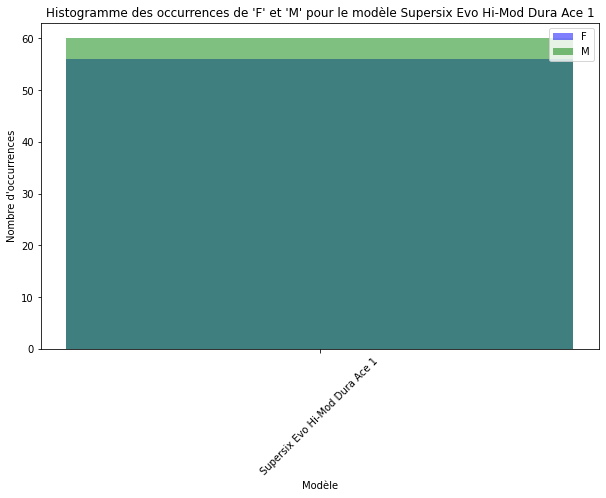

In [0]:
import matplotlib.pyplot as plt

# Modèle spécifique que vous souhaitez examiner
modele_a = "Supersix Evo Hi-Mod Dura Ace 1"  # Remplacez par le modèle souhaité

# Filtrer le DataFrame pour le modèle spécifique et les sexes "F" et "M"
filtered_df = groupe_sexe.filter(groupe_sexe["model"] == modele_a)

# Convertir le DataFrame filtré en Pandas pour la visualisation
pandas_df = filtered_df.toPandas()

# Créer un histogramme distinct pour les deux sexes
plt.figure(figsize=(10, 6))

plt.bar(pandas_df["model"], pandas_df["count_F"], alpha=0.5, label="F", color="blue", width=0.4)
plt.bar(pandas_df["model"], pandas_df["count_M"], alpha=0.5, label="M", color="green", width=0.4)

plt.xlabel("Modèle")
plt.ylabel("Nombre d'occurrences")
plt.title(f"Histogramme des occurrences de 'F' et 'M' pour le modèle {modele_a}")
plt.legend()
plt.xticks(rotation=45)
plt.show()


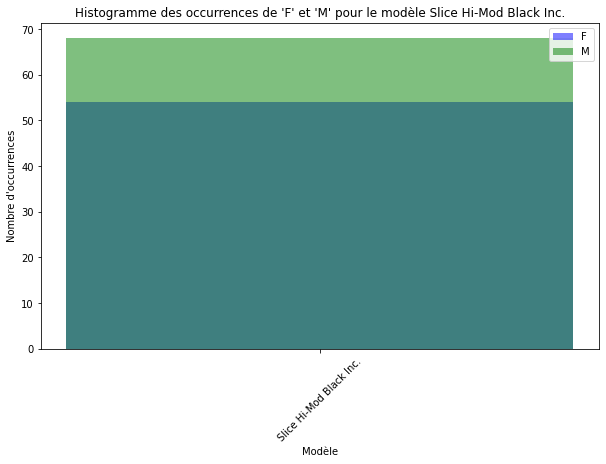

In [0]:
import matplotlib.pyplot as plt

# Modèle spécifique que vous souhaitez examiner
modele_a = "Slice Hi-Mod Black Inc."  # Remplacez par le modèle souhaité

# Filtrer le DataFrame pour le modèle spécifique et les sexes "F" et "M"
filtered_df = groupe_sexe.filter(groupe_sexe["model"] == modele_a)

# Convertir le DataFrame filtré en Pandas pour la visualisation
pandas_df = filtered_df.toPandas()

# Créer un histogramme distinct pour les deux sexes
plt.figure(figsize=(10, 6))

plt.bar(pandas_df["model"], pandas_df["count_F"], alpha=0.5, label="F", color="blue", width=0.4)
plt.bar(pandas_df["model"], pandas_df["count_M"], alpha=0.5, label="M", color="green", width=0.4)

plt.xlabel("Modèle")
plt.ylabel("Nombre d'occurrences")
plt.title(f"Histogramme des occurrences de 'F' et 'M' pour le modèle {modele_a}")
plt.legend()
plt.xticks(rotation=45)
plt.show()

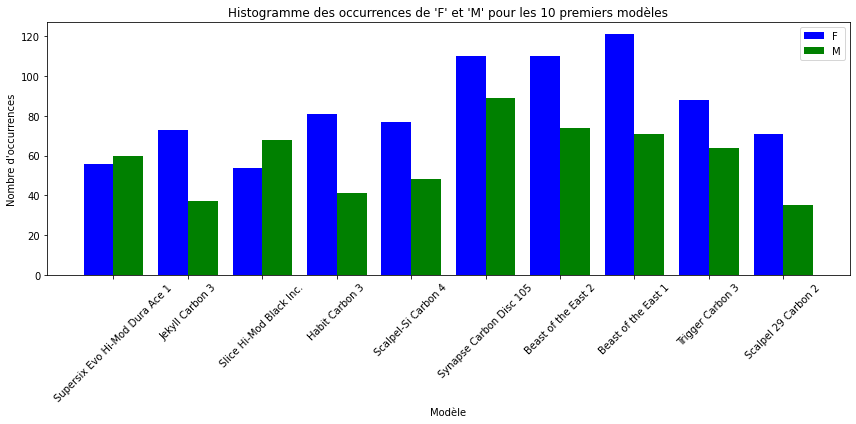

In [0]:
import matplotlib.pyplot as plt

# Nombre de premiers modèles que vous souhaitez inclure
nombre_de_premiers_modeles = 10

# Récupérer les 10 premiers modèles uniques
top_10_modeles = [row.model for row in groupe_sexe.select("model").distinct().limit(nombre_de_premiers_modeles).collect()]

# Créer un sous-tracé pour chaque modèle
fig, ax = plt.subplots(figsize=(12, 6))

# Couleurs pour les sexes "F" et "M"
colors = ['blue', 'green']

# Largeur des barres pour chaque modèle
bar_width = 0.4

# Position des modèles sur l'axe des x
x_positions = range(len(top_10_modeles))

# Itérer à travers les modèles
for i, sexe in enumerate(['count_F', 'count_M']):
    counts = [groupe_sexe.filter((groupe_sexe["model"] == modele) & (groupe_sexe["model"].isin(top_10_modeles))).select(sexe).first()[0] for modele in top_10_modeles]
    
    # Créer un histogramme distinct pour le sexe
    ax.bar([x + i * bar_width for x in x_positions], counts, width=bar_width, label=sexe, color=colors[i])

# Configurer les étiquettes et la légende
ax.set_xlabel("Modèle")
ax.set_ylabel("Nombre d'occurrences")
ax.set_title(f"Histogramme des occurrences de 'F' et 'M' pour les {nombre_de_premiers_modeles} premiers modèles")
ax.set_xticks([x + bar_width / 2 for x in x_positions])
ax.set_xticklabels(top_10_modeles, rotation=45)
ax.legend(['F', 'M'])

plt.tight_layout()
plt.show()


Calcul du nombre d'achat des modeles par  villes

In [0]:
#NB achat de model de velos par ville
groupe_shopname = df.groupBy("model").pivot("bikeshop_city").agg(F.count("*"))
display(groupe_shopname)

model,Albuquerque,Ann Arbor,Austin,Cincinnati,Columbus,Dallas,Denver,Detroit,Indianapolis,Ithaca,Kansas City,Las Vegas,Los Angeles,Louisville,Miami,Minneapolis,Nashville,New Orleans,New York,Oklahoma City,Philadelphia,Phoenix,Pittsburgh,Portland,Providence,San Antonio,San Francisco,Seattle,Tampa,Wichita
Supersix Evo Hi-Mod Dura Ace 1,2,null,3,12,11,2,3,6,null,13,5,4,1,8,null,4,6,1,5,6,null,5,16,1,null,null,2,null,null,null
Jekyll Carbon 3,5,1,3,8,9,3,10,11,null,15,7,2,1,5,1,2,5,1,2,5,1,2,8,null,null,2,null,1,null,null
Slice Hi-Mod Black Inc.,7,2,4,8,6,7,2,9,null,9,5,2,4,7,null,4,6,3,3,2,1,7,17,2,1,null,2,1,1,null
Habit Carbon 3,3,4,2,9,12,7,8,12,null,10,6,null,4,3,null,4,3,null,7,7,1,2,13,2,1,null,null,1,1,null
Scalpel-Si Carbon 4,2,4,3,12,5,3,6,8,null,8,6,2,1,10,2,6,7,1,3,6,null,4,22,null,null,null,3,1,null,null
Beast of the East 2,3,4,4,10,16,2,9,14,null,16,5,3,3,13,3,7,4,null,9,5,2,5,31,4,3,1,3,4,1,null
Synapse Carbon Disc 105,6,2,2,18,19,5,14,10,null,18,4,2,4,14,1,10,10,1,6,10,null,3,23,4,3,1,6,2,null,1
Beast of the East 1,2,null,9,13,16,2,4,12,1,27,4,1,2,12,null,8,11,2,9,5,4,3,29,2,4,null,5,5,null,null
Trigger Carbon 3,6,2,3,10,11,3,7,11,null,17,10,6,1,10,null,9,5,null,7,3,null,1,19,1,1,4,1,2,null,2
Synapse Disc Tiagra,4,1,6,7,15,3,15,16,1,21,9,3,2,15,3,9,8,1,11,7,1,7,21,3,3,1,2,5,1,2


Histogramme du nombre d'achat d'un model de vélos dans les villes

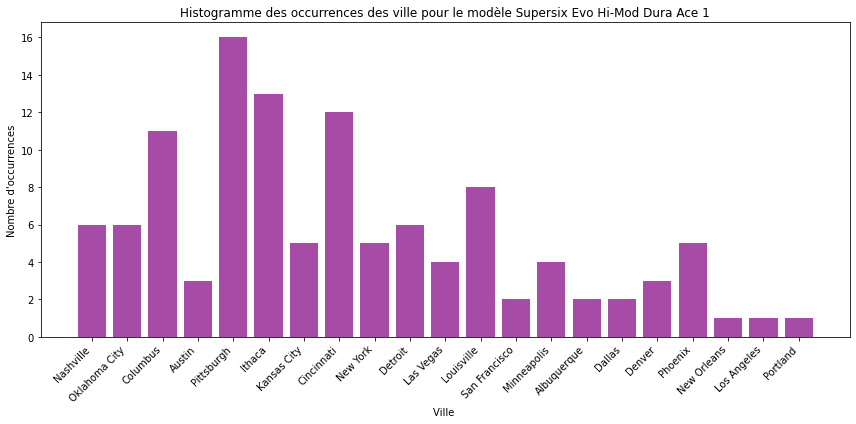

In [0]:

import matplotlib.pyplot as plt

# Modèle spécifique que vous souhaitez examiner
modele_a = "Supersix Evo Hi-Mod Dura Ace 1"  # Remplacez par le modèle souhaité

# Filtrer le DataFrame pour le modèle spécifique et les magasins (bikeshop_name)
filtered_df = df.filter(df["model"] == modele_a)

# Grouper par "bikeshop_name" et compter les occurrences de chaque magasin
shop_counts = filtered_df.groupBy("bikeshop_city").count().toPandas()

# Créer un histogramme distinct pour les magasins
plt.figure(figsize=(12, 6))
plt.bar(shop_counts["bikeshop_city"], shop_counts["count"], alpha=0.7, color="purple")

plt.xlabel("Ville ")
plt.ylabel("Nombre d'occurrences")
plt.title(f"Histogramme des occurrences des ville pour le modèle {modele_a}")
plt.xticks(rotation=45, fontsize=10, ha="right")  # Ajustez la taille et la rotation des étiquettes
plt.tight_layout()
plt.show()


Top 1 du model le plus vendus dans chaque magasin (ville)

In [0]:
from pyspark.sql.window import Window
import pyspark.sql.functions as F

# Créer une fenêtre de partitionnement par ville (bikeshop_name) et classer par nombre de ventes décroissant
window_spec = Window.partitionBy("bikeshop_name").orderBy(F.desc("count"))

# Calculer le classement des modèles par ville
ranked_df = df.groupBy("bikeshop_name", "model").count().withColumn("rank", F.rank().over(window_spec))

# Filtrer les modèles avec un classement de 1 (les plus vendus) pour chaque ville
top_models_by_city = ranked_df.filter(ranked_df["rank"] == 1).select("bikeshop_name", "model", "count")

# Afficher le résultat
top_models_by_city.show()



+--------------------+--------------------+-----+
|       bikeshop_name|               model|count|
+--------------------+--------------------+-----+
|  Albuquerque Cycles|   Slice Ultegra D12|   14|
|     Ann Arbor Speed|           CAAD8 105|    5|
|     Ann Arbor Speed|  Synapse Carbon 105|    5|
|     Ann Arbor Speed|      SuperX Ultegra|    5|
|     Austin Cruisers|              F-Si 2|   11|
|    Cincinnati Speed|             Trail 5|   20|
|    Cincinnati Speed|    Supersix Evo 105|   20|
|Columbus Race Equ...|        Scalpel 29 4|   23|
|Columbus Race Equ...|  Synapse Carbon 105|   23|
|       Dallas Cycles|        Synapse Sora|   13|
|    Denver Bike Shop|     CAAD12 Disc 105|   17|
|      Detroit Cycles|        Scalpel 29 4|   24|
|Indianapolis Velo...|           Fat CAAD2|    3|
|Indianapolis Velo...|   Slice Ultegra D12|    3|
|Ithaca Mountain C...|             Trail 5|   28|
|Ithaca Mountain C...|     Jekyll Carbon 4|   28|
|   Kansas City 29ers|              F-Si 3|   15|


Machine Learning :   le but est de regrouper les clients en fonction de caractéristiques similaires et attribuer un modèle de vélo spécifique à chaque groupe

In [0]:
from pyspark.ml.feature import StringIndexer, OneHotEncoder
from pyspark.ml import Pipeline
from pyspark.ml.feature import VectorAssembler


# Sélectionner les colonnes pertinentes
selected_columns = ['customer_age', 'customer_sexe', 'bikeshop_name', 'bikeshop_city','model']
df_model = df.select(*selected_columns)

# Gérer les variables catégorielles
indexers = [StringIndexer(inputCol=col, outputCol=col + "_index") for col in ['customer_sexe', 'bikeshop_name', 'bikeshop_city']]
pipeline = Pipeline(stages=indexers)
df_model = pipeline.fit(df_model).transform(df_model)

# Assembler les caractéristiques en un vecteur
feature_columns = ['customer_age', 'customer_sexe_index', 'bikeshop_name_index', 'bikeshop_city_index']
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")

df_model = assembler.transform(df_model)

# Indexez la variable cible "model" pour la convertir en valeurs numériques
indexer_model = StringIndexer(inputCol="model", outputCol="label", handleInvalid="skip")

df_final= indexer_model.fit(df_model).transform(df_model)


Separation des données en ensembles d'apprentissage et de test 

In [0]:
train_data, test_data = df_final.randomSplit([0.8, 0.2], seed=42)
print(train_data.count())
print(test_data.count())

12629
3015


In [0]:
train_data.display()


customer_age,customer_sexe,bikeshop_name,bikeshop_city,model,customer_sexe_index,bikeshop_name_index,bikeshop_city_index,features,label
9,M,Albuquerque Cycles,Albuquerque,Habit 4,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",51.0
9,M,Albuquerque Cycles,Albuquerque,Jekyll Carbon 3,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",93.0
9,M,Albuquerque Cycles,Albuquerque,Slice Hi-Mod Black Inc.,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",80.0
9,M,Albuquerque Cycles,Albuquerque,Slice Ultegra D12,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",0.0
9,M,Albuquerque Cycles,Albuquerque,SuperX Hi-Mod CX1,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",61.0
9,M,Albuquerque Cycles,Albuquerque,Synapse Hi-Mod Disc Red,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",66.0
9,M,Albuquerque Cycles,Albuquerque,Trail 4,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",27.0
9,M,Ann Arbor Speed,Ann Arbor,F-Si Carbon 4,1.0,21.0,21.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 21.0, 21.0))",7.0
9,M,Ann Arbor Speed,Ann Arbor,Habit Carbon 1,1.0,21.0,21.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 21.0, 21.0))",92.0
9,M,Ann Arbor Speed,Ann Arbor,Scalpel-Si Race,1.0,21.0,21.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 21.0, 21.0))",60.0


In [0]:
selected_columns1 = ['customer_age', 'customer_sexe', 'bikeshop_name', 'bikeshop_city','model','label']
affichage1 = train_data.select(*selected_columns1)
affichage1.display()

customer_age,customer_sexe,bikeshop_name,bikeshop_city,model,label
9,M,Albuquerque Cycles,Albuquerque,Habit 4,51.0
9,M,Albuquerque Cycles,Albuquerque,Jekyll Carbon 3,93.0
9,M,Albuquerque Cycles,Albuquerque,Slice Hi-Mod Black Inc.,80.0
9,M,Albuquerque Cycles,Albuquerque,Slice Ultegra D12,0.0
9,M,Albuquerque Cycles,Albuquerque,SuperX Hi-Mod CX1,61.0
9,M,Albuquerque Cycles,Albuquerque,Synapse Hi-Mod Disc Red,66.0
9,M,Albuquerque Cycles,Albuquerque,Trail 4,27.0
9,M,Ann Arbor Speed,Ann Arbor,F-Si Carbon 4,7.0
9,M,Ann Arbor Speed,Ann Arbor,Habit Carbon 1,92.0
9,M,Ann Arbor Speed,Ann Arbor,Scalpel-Si Race,60.0


Entrainement des données avec quelques algorithmes de classifications: 

Avec le model Random forest

In [0]:
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

# Créez le modèle Random Forest
rf = RandomForestClassifier(featuresCol="features", labelCol="label" , numTrees=5 ,seed=42)

# Entraînez le modèle sur les données d'entraînement
rf_model = rf.fit(train_data)

# Faites des prédictions sur les données de test
predictions_rf = rf_model.transform(test_data)



# Évaluation 
evaluator = MulticlassClassificationEvaluator(labelCol="label", metricName="f1")
f1_score = evaluator.evaluate(predictions_rf)


print("Performance du Random Forest:", f1_score) 


# Évaluez les performances du modèle
#evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")
#accuracy = evaluator.evaluate(predictions_rf)
#print("Performance du Random Forest:", accuracy)

# Affichez les prédictions et les étiquettes réelles
#predictions_rf.select("model", "prediction").show()



Performance du Random Forest: 0.0064000870136003765


Avec K-Means : Utilisé pour regrouper les clients en clusters sans prédire le modèle de vélo spécifique  (K-Means pour regrouper les clients en fonction de caractéristiques similaires.)

In [0]:
from pyspark.ml.clustering import KMeans
from pyspark.ml.evaluation import ClusteringEvaluator

# Créez un modèle K-Means avec le nombre de clusters souhaité
kmeans = KMeans(featuresCol="features", k=3)  # Spécifiez le nombre de clusters souhaité

# Entraînez le modèle sur les données d'entraînement
kmeans_model = kmeans.fit(train_data)

# Obtenez les clusters attribués aux données de test
cluster_predictions = kmeans_model.transform(test_data)


# Évaluation du modèle de clustering K-Means
evaluator = ClusteringEvaluator()
performance = evaluator.evaluate(cluster_predictions)
print(f"Performance Score du K-Means: {performance}")


Performance Score du K-Means: 0.576407455402104


In [0]:
cluster_predictions.display()

customer_age,customer_sexe,bikeshop_name,bikeshop_city,model,customer_sexe_index,bikeshop_name_index,bikeshop_city_index,features,label,prediction
9,M,Albuquerque Cycles,Albuquerque,Scalpel-Si Race,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",60.0,1
9,M,Albuquerque Cycles,Albuquerque,Supersix Evo Hi-Mod Utegra,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",72.0,1
9,M,Albuquerque Cycles,Albuquerque,Synapse Hi-Mod Disc Ultegra,1.0,13.0,13.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 13.0, 13.0))",95.0,1
9,M,Austin Cruisers,Austin,F-Si 3,1.0,14.0,14.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 14.0, 14.0))",39.0,1
9,M,Austin Cruisers,Austin,Trail 2,1.0,14.0,14.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 14.0, 14.0))",6.0,1
9,M,Cincinnati Speed,Cincinnati,Fat CAAD1,1.0,4.0,4.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 4.0, 4.0))",87.0,1
9,M,Cincinnati Speed,Cincinnati,Synapse Hi-Mod Dura Ace,1.0,4.0,4.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 4.0, 4.0))",86.0,1
9,M,Cincinnati Speed,Cincinnati,Trigger Carbon 2,1.0,4.0,4.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 4.0, 4.0))",69.0,1
9,M,Columbus Race Equipment,Columbus,Scalpel-Si 5,1.0,2.0,2.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 2.0, 2.0))",13.0,1
9,M,Columbus Race Equipment,Columbus,Scalpel-Si Carbon 2,1.0,2.0,2.0,"Map(vectorType -> dense, length -> 4, values -> List(9.0, 1.0, 2.0, 2.0))",64.0,1


In [0]:
selected_columns2 = ['customer_age', 'customer_sexe', 'bikeshop_name', 'bikeshop_city','customer_sexe_index','bikeshop_name_index','bikeshop_city_index','label','prediction']
affichage2 = cluster_predictions.select(*selected_columns2)
affichage2.display()

customer_age,customer_sexe,bikeshop_name,bikeshop_city,customer_sexe_index,bikeshop_name_index,bikeshop_city_index,label,prediction
9,M,Albuquerque Cycles,Albuquerque,1.0,13.0,13.0,60.0,1
9,M,Albuquerque Cycles,Albuquerque,1.0,13.0,13.0,72.0,1
9,M,Albuquerque Cycles,Albuquerque,1.0,13.0,13.0,95.0,1
9,M,Austin Cruisers,Austin,1.0,14.0,14.0,39.0,1
9,M,Austin Cruisers,Austin,1.0,14.0,14.0,6.0,1
9,M,Cincinnati Speed,Cincinnati,1.0,4.0,4.0,87.0,1
9,M,Cincinnati Speed,Cincinnati,1.0,4.0,4.0,86.0,1
9,M,Cincinnati Speed,Cincinnati,1.0,4.0,4.0,69.0,1
9,M,Columbus Race Equipment,Columbus,1.0,2.0,2.0,13.0,1
9,M,Columbus Race Equipment,Columbus,1.0,2.0,2.0,64.0,1


Regression logistic

In [0]:
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

# Créez un modèle de régression logistique
lr = LogisticRegression(featuresCol="features", labelCol="label", maxIter=10, regParam=0.3, elasticNetParam=0.8)

# Entraînez le modèle sur les données d'entraînement
lr_model = lr.fit(train_data)

# Faites des prédictions sur les données de test
predictions = lr_model.transform(test_data)

# Évaluation multiclasse (par exemple, si vous avez plusieurs classes)
evaluator_multiclass = MulticlassClassificationEvaluator(labelCol="label", metricName="f1")
f1_score_multiclass = evaluator_multiclass.evaluate(predictions)

print(f1_score_multiclass)


0.0003137495185932984


Choix du modèle : K-Means

Prédire un nouveau client

In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.sql import SparkSession
from pyspark.ml.clustering import KMeans
from pyspark.sql import Row

# Initialiser une session Spark
spark = SparkSession.builder.appName("ClusteringExample").getOrCreate()
MulticlassClassificationEvaluator

#selected_columns = ['customer_age', 'customer_sexe', 'bikeshop_name', 'bikeshop_city','model']

# Préparer les caractéristiques du nouveau client (remplacez les valeurs par celles du nouveau client)
new_customer_features = [42, 0, 13, 13]  # Exemple de caractéristiques du nouveau client

# Créer un Row contenant les caractéristiques du nouveau client
new_customer_row = Row(customer_age=new_customer_features[0], customer_sexe_index=new_customer_features[1], bikeshop_name_index=new_customer_features[2], bikeshop_city_index=new_customer_features[3])

# Créer un DataFrame à partir du Row
new_customer_df = spark.createDataFrame([new_customer_row])

# Assembler les caractéristiques du nouveau client en un vecteur
feature_columns = ['customer_age', 'customer_sexe_index', 'bikeshop_name_index', 'bikeshop_city_index']
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")
new_customer_df = assembler.transform(new_customer_df)

# Utiliser le modèle K-Means pour prédire le cluster du nouveau client
cluster_prediction = kmeans_model.transform(new_customer_df)

# Le cluster auquel le nouveau client appartient
predicted_cluster = cluster_prediction.select("prediction").first()[0]

# À ce stade, vous avez le cluster auquel appartient le nouveau client
print(f"Le nouveau client appartient au cluster {predicted_cluster}")




Le nouveau client appartient au cluster 2


In [0]:
# Créez un dictionnaire de correspondance entre les clusters et les modèles
cluster_to_model = {
    0: "Slice Ultegra D12",
    1: "CAAD8 105",
    2: "Slice 105 / CAAD8 Sora"
    # Ajoutez autant de correspondances que nécessaire
}

# À ce stade, vous avez déjà prédit le cluster auquel appartient le nouveau client et stocké dans predicted_cluster

# Obtenez le modèle correspondant au cluster prédit
predicted_model = cluster_to_model.get(predicted_cluster, "Modèle Inconnu")

# Affichez le modèle attribué au cluster
print(f"Le nouveau client est susceptible d'aimer le modèle : {predicted_model}")


Le nouveau client est susceptible d'aimer le modèle : Slice 105 / CAAD8 Sora
